In [42]:
%run common-imports.ipynb # TODO:

<h1>Table of Contents<span class="tocSkip"></span></h1>
<div class="toc"><ul class="toc-item"><li><span><a href="#Exploratory-data-analysis-for-the-housing-dataset" data-toc-modified-id="Exploratory-data-analysis-for-the-housing-dataset-1"><span class="toc-item-num">1&nbsp;&nbsp;</span>Exploratory data analysis for the housing dataset</a></span><ul class="toc-item"><li><span><a href="#Styling-the-table-with-a-splash-of-color" data-toc-modified-id="Styling-the-table-with-a-splash-of-color-1.1"><span class="toc-item-num">1.1&nbsp;&nbsp;</span>Styling the table with a splash of color</a></span></li><li><span><a href="#Missing-Value-Analysis" data-toc-modified-id="Missing-Value-Analysis-1.2"><span class="toc-item-num">1.2&nbsp;&nbsp;</span>Missing Value Analysis</a></span></li><li><span><a href="#Drop-missing-values-for-now" data-toc-modified-id="Drop-missing-values-for-now-1.3"><span class="toc-item-num">1.3&nbsp;&nbsp;</span>Drop missing values for now</a></span></li><li><span><a href="#Draw-the-map-of-California" data-toc-modified-id="Draw-the-map-of-California-1.4"><span class="toc-item-num">1.4&nbsp;&nbsp;</span>Draw the map of California</a></span></li></ul></li><li><span><a href="#Basic-Regression-Model" data-toc-modified-id="Basic-Regression-Model-2"><span class="toc-item-num">2&nbsp;&nbsp;</span>Basic Regression Model</a></span><ul class="toc-item"><li><span><a href="#Data-Preprocessing" data-toc-modified-id="Data-Preprocessing-2.1"><span class="toc-item-num">2.1&nbsp;&nbsp;</span>Data Preprocessing</a></span></li><li><span><a href="#Log-transform" data-toc-modified-id="Log-transform-2.2"><span class="toc-item-num">2.2&nbsp;&nbsp;</span>Log transform</a></span></li><li><span><a href="#Data-split-into-train-and-test" data-toc-modified-id="Data-split-into-train-and-test-2.3"><span class="toc-item-num">2.3&nbsp;&nbsp;</span>Data split into train and test</a></span></li><li><span><a href="#Simple-linear-regression-model" data-toc-modified-id="Simple-linear-regression-model-2.4"><span class="toc-item-num">2.4&nbsp;&nbsp;</span>Simple linear regression model</a></span><ul class="toc-item"><li><span><a href="#Prediction-Errors-Plot" data-toc-modified-id="Prediction-Errors-Plot-2.4.1"><span class="toc-item-num">2.4.1&nbsp;&nbsp;</span>Prediction Errors Plot</a></span></li><li><span><a href="#Cook's-Distance-to-see-point-of-high-influence-(leverage)" data-toc-modified-id="Cook's-Distance-to-see-point-of-high-influence-(leverage)-2.4.2"><span class="toc-item-num">2.4.2&nbsp;&nbsp;</span>Cook's Distance to see point of high influence (leverage)</a></span></li></ul></li><li><span><a href="#Would-regularlization-help?" data-toc-modified-id="Would-regularlization-help?-2.5"><span class="toc-item-num">2.5&nbsp;&nbsp;</span>Would regularlization help?</a></span><ul class="toc-item"><li><span><a href="#Prediction-Errors-Plot" data-toc-modified-id="Prediction-Errors-Plot-2.5.1"><span class="toc-item-num">2.5.1&nbsp;&nbsp;</span>Prediction Errors Plot</a></span></li></ul></li></ul></li></ul></div>

# Exploratory data analysis for the housing dataset

In [43]:
data = pd.read_csv("../datasets/housing.csv") # reading and storing the dataset in a pandas dataframe

In [44]:
data.describe(include='all').transpose()

,count,unique,top,freq,mean,std,min,25%,50%,75%,max
longitude,20640.0,NaN,NaN,NaN,-119.569704,2.003532,-124.35,-121.8,-118.49,-118.01,-114.31
latitude,20640.0,NaN,NaN,NaN,35.631861,2.135952,32.54,33.93,34.26,37.71,41.95
housing_median_age,20640.0,NaN,NaN,NaN,28.639486,12.585558,1.0,18.0,29.0,37.0,52.0
total_rooms,20640.0,NaN,NaN,NaN,2635.763081,2181.615252,2.0,1447.75,2127.0,3148.0,39320.0
total_bedrooms,20433.0,NaN,NaN,NaN,537.870553,421.38507,1.0,296.0,435.0,647.0,6445.0
population,20640.0,NaN,NaN,NaN,1425.476744,1132.462122,3.0,787.0,1166.0,1725.0,35682.0
households,20640.0,NaN,NaN,NaN,499.53968,382.329753,1.0,280.0,409.0,605.0,6082.0
median_income,20640.0,NaN,NaN,NaN,3.870671,1.899822,0.4999,2.5634,3.5348,4.74325,15.0001
median_house_value,20640.0,NaN,NaN,NaN,206855.816909,115395.615874,14999.0,119600.0,179700.0,264725.0,500001.0
ocean_proximity,20640,5,<1H OCEAN,9136,NaN,NaN,NaN,NaN,NaN,NaN,NaN


## Styling the table with a splash of color

In [45]:
(data.describe(include='all').transpose())# .style.set_table_styles(sv_table_styles())

,count,unique,top,freq,mean,std,min,25%,50%,75%,max
longitude,20640.0,NaN,NaN,NaN,-119.569704,2.003532,-124.35,-121.8,-118.49,-118.01,-114.31
latitude,20640.0,NaN,NaN,NaN,35.631861,2.135952,32.54,33.93,34.26,37.71,41.95
housing_median_age,20640.0,NaN,NaN,NaN,28.639486,12.585558,1.0,18.0,29.0,37.0,52.0
total_rooms,20640.0,NaN,NaN,NaN,2635.763081,2181.615252,2.0,1447.75,2127.0,3148.0,39320.0
total_bedrooms,20433.0,NaN,NaN,NaN,537.870553,421.38507,1.0,296.0,435.0,647.0,6445.0
population,20640.0,NaN,NaN,NaN,1425.476744,1132.462122,3.0,787.0,1166.0,1725.0,35682.0
households,20640.0,NaN,NaN,NaN,499.53968,382.329753,1.0,280.0,409.0,605.0,6082.0
median_income,20640.0,NaN,NaN,NaN,3.870671,1.899822,0.4999,2.5634,3.5348,4.74325,15.0001
median_house_value,20640.0,NaN,NaN,NaN,206855.816909,115395.615874,14999.0,119600.0,179700.0,264725.0,500001.0
ocean_proximity,20640,5,<1H OCEAN,9136,NaN,NaN,NaN,NaN,NaN,NaN,NaN


## Missing Value Analysis

Let us study the severity of missing values for each of the features.

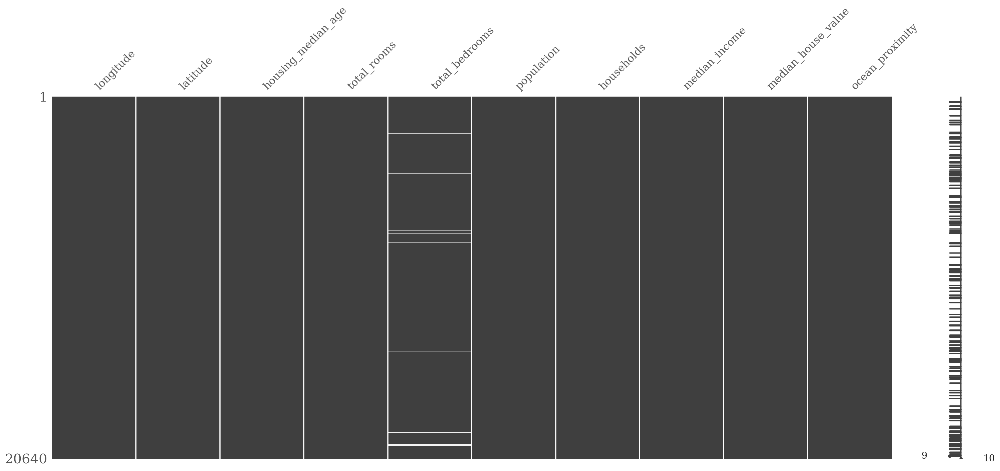

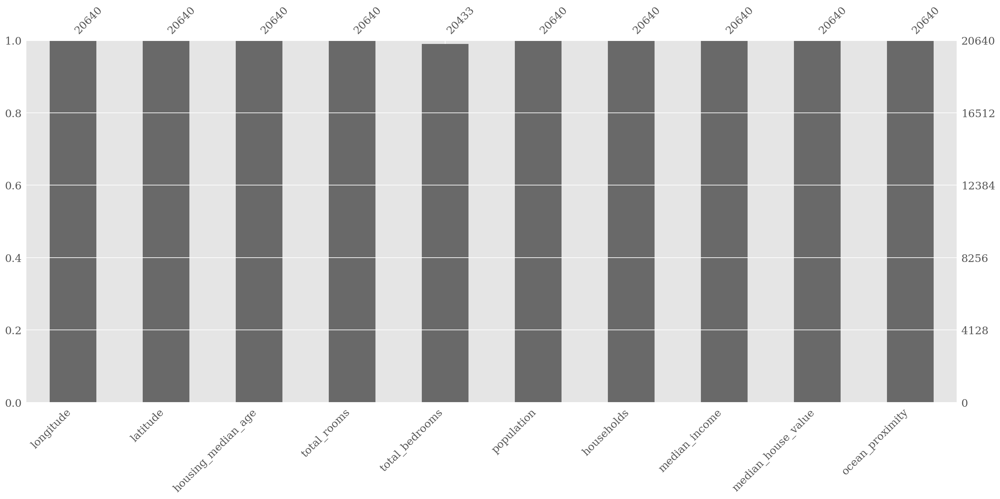

In [46]:
# Missingno library breaks with latex, will temporarily turn it off.
rc ('text', usetex=False)
import missingno as msno
msno.matrix(data);
plt.show()
msno.bar(data);
plt.show()


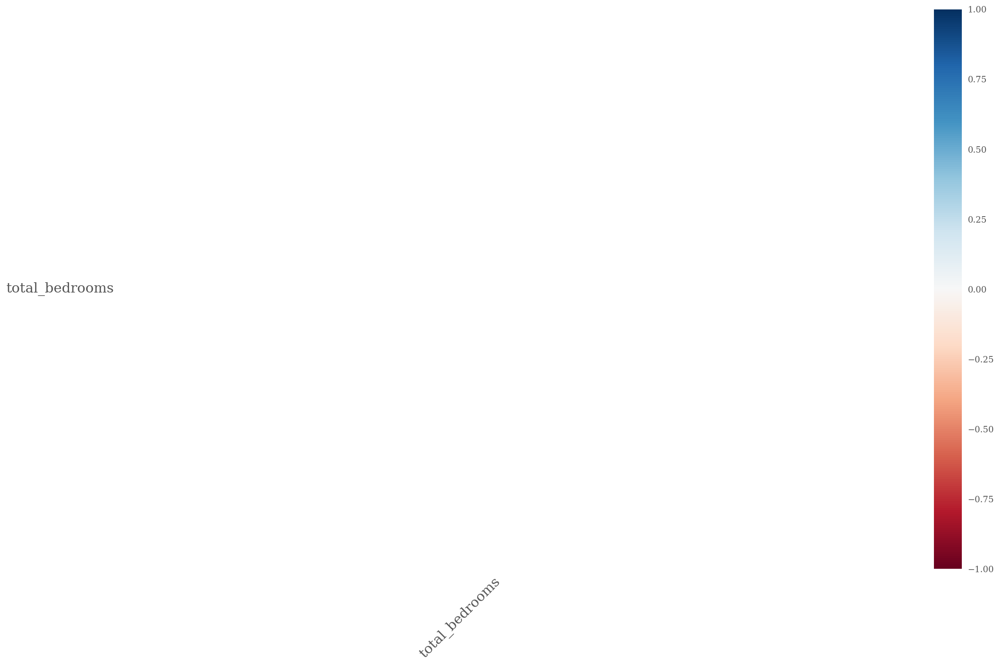

In [47]:
msno.heatmap(data);

<AxesSubplot:>

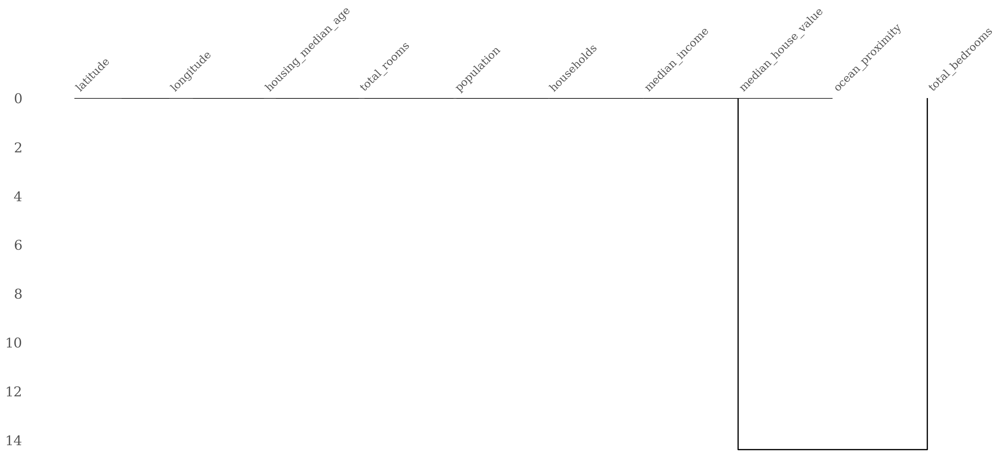

In [48]:
msno.dendrogram(data)

In [49]:
data.profile_report()

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

## Drop missing values for now

In [50]:
# Since very few rows have missing total-bedroom feature, let us drop those rows.

data.dropna(inplace=True)

In [51]:
rc ('text', usetex=False) # Re-enable it.

 ## Draw the map of California

In [52]:

import folium
plt.rcParams['figure.figsize'] = '20,20'

# Find the center of california
max_x, min_x      = data['longitude'].max(), data['longitude'].min()
max_y, min_y      = data['latitude'].max(), data['latitude'].min()
center_longitude, center_latitude   = (max_x+min_x)/2, (max_y+min_y)/2

# Plot the map of California
m = folium.Map(location=[center_latitude, center_longitude], zoom_start=5.5)


for index, row in data.iterrows():
    folium.Circle(
    radius=3,
    location=[row.latitude, row.longitude],
    color='#E74C3C',
    opacity=0.05,
    fill=False,
    ).add_to(m)

m

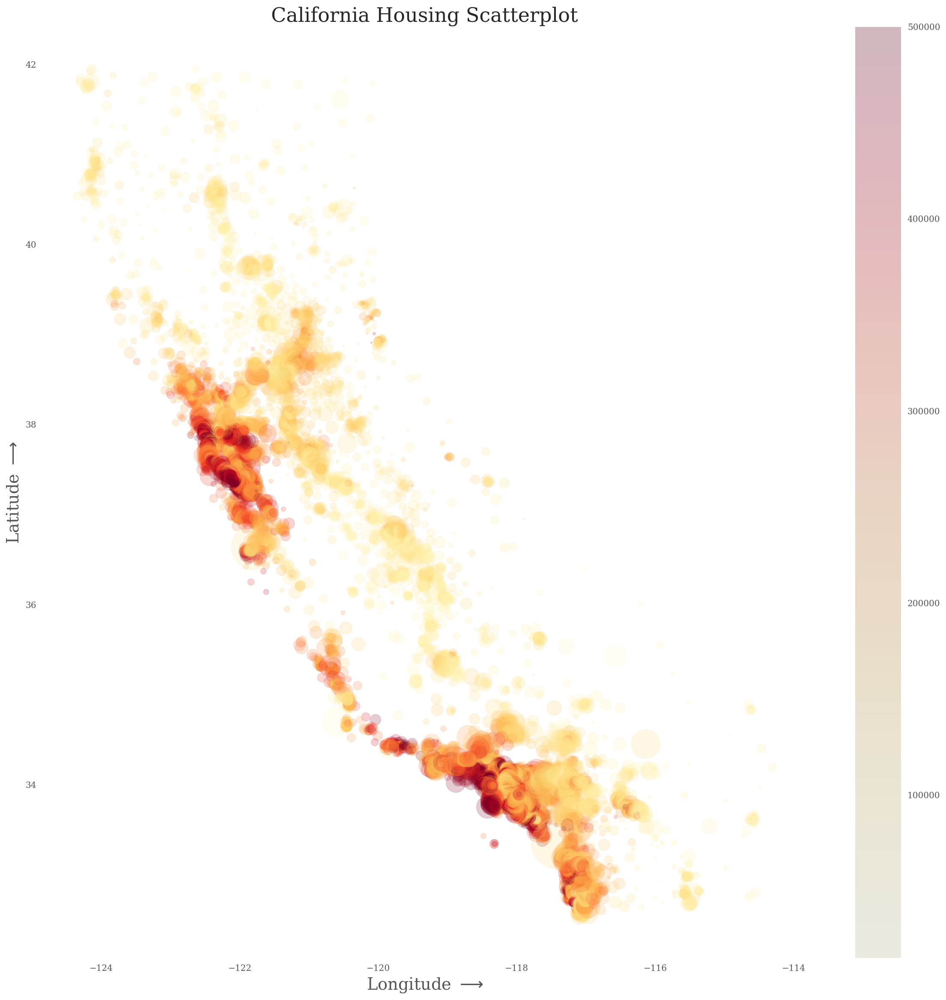

In [53]:



plt.scatter(x    = data.longitude, 
            y    = data.latitude, 
            c    = data.median_house_value, 
            cmap = 'YlOrRd', 
            s    = data.population/10, 
            alpha= 0.2);
ax = plt.gca();
ax.set_facecolor('#FFFFFF')
plt.xlabel(r'Longitude $\longrightarrow$')
plt.ylabel(r'Latitude $\longrightarrow$')
plt.title(r'California Housing Scatterplot')

plt.colorbar();

In [54]:
import matplotlib.image as mpimg

#img1 = mpimg.imread('california-housing-map.png')
#img2 = mpimg.imread('california-housing-scatterplot.png')

In [55]:
#plt.rcParams['figure.figsize'] = '25,25'

#plt.figure(1)
#plt.title(r'\textbf{California Housing}')

#plt.subplot(121);
#plt.imshow(img1);

#plt.subplot(122);
#plt.imshow(img2);



In [56]:
data.ocean_proximity = data.ocean_proximity.astype('category')

In [57]:
data.describe(include='all').transpose()

,count,unique,top,freq,mean,std,min,25%,50%,75%,max
longitude,20433.0,NaN,NaN,NaN,-119.570689,2.003578,-124.35,-121.8,-118.49,-118.01,-114.31
latitude,20433.0,NaN,NaN,NaN,35.633221,2.136348,32.54,33.93,34.26,37.72,41.95
housing_median_age,20433.0,NaN,NaN,NaN,28.633094,12.591805,1.0,18.0,29.0,37.0,52.0
total_rooms,20433.0,NaN,NaN,NaN,2636.504233,2185.269567,2.0,1450.0,2127.0,3143.0,39320.0
total_bedrooms,20433.0,NaN,NaN,NaN,537.870553,421.38507,1.0,296.0,435.0,647.0,6445.0
population,20433.0,NaN,NaN,NaN,1424.946949,1133.20849,3.0,787.0,1166.0,1722.0,35682.0
households,20433.0,NaN,NaN,NaN,499.433465,382.299226,1.0,280.0,409.0,604.0,6082.0
median_income,20433.0,NaN,NaN,NaN,3.871162,1.899291,0.4999,2.5637,3.5365,4.744,15.0001
median_house_value,20433.0,NaN,NaN,NaN,206864.413155,115435.667099,14999.0,119500.0,179700.0,264700.0,500001.0
ocean_proximity,20433,5,<1H OCEAN,9034,NaN,NaN,NaN,NaN,NaN,NaN,NaN


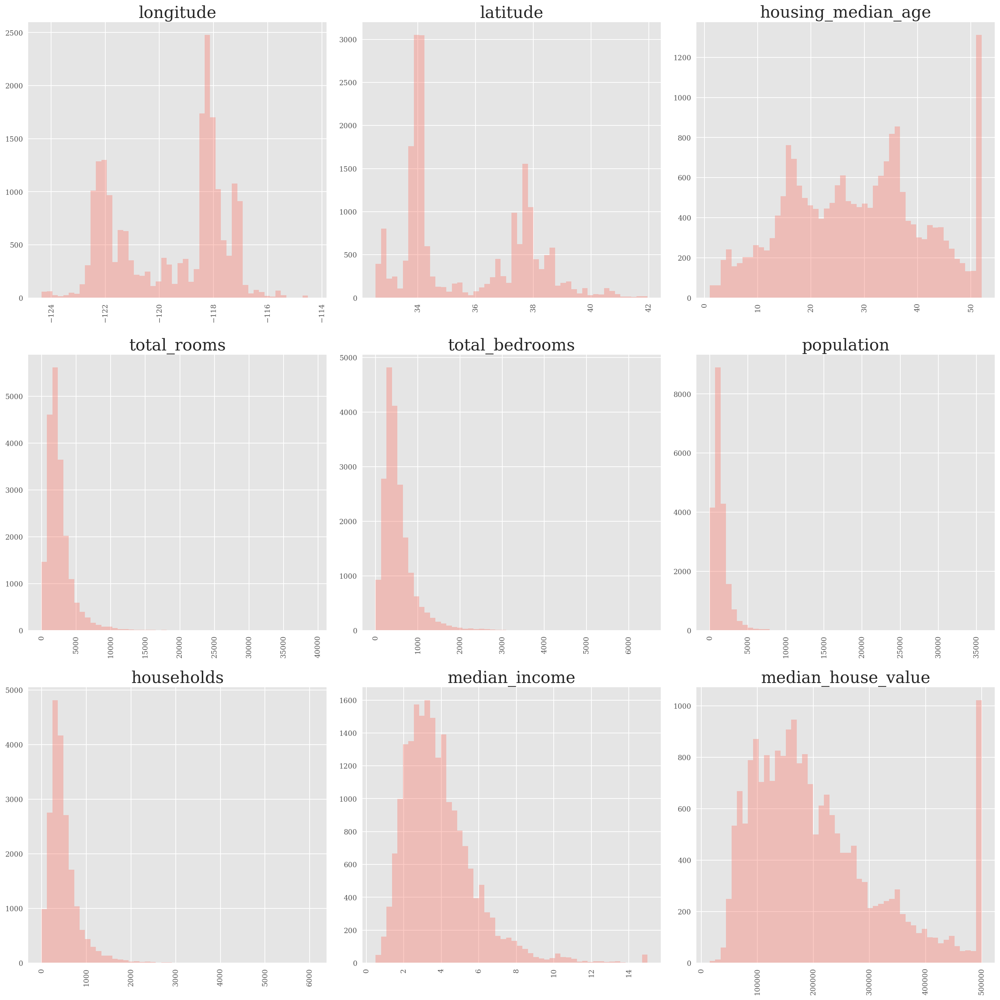

In [58]:
rc('text', usetex=False)
data.hist(bins=50, alpha = 0.4, color='salmon', xrot=90, figsize=(20,20));
plt.tight_layout()

IndexError: index 1 is out of bounds for axis 0 with size 1

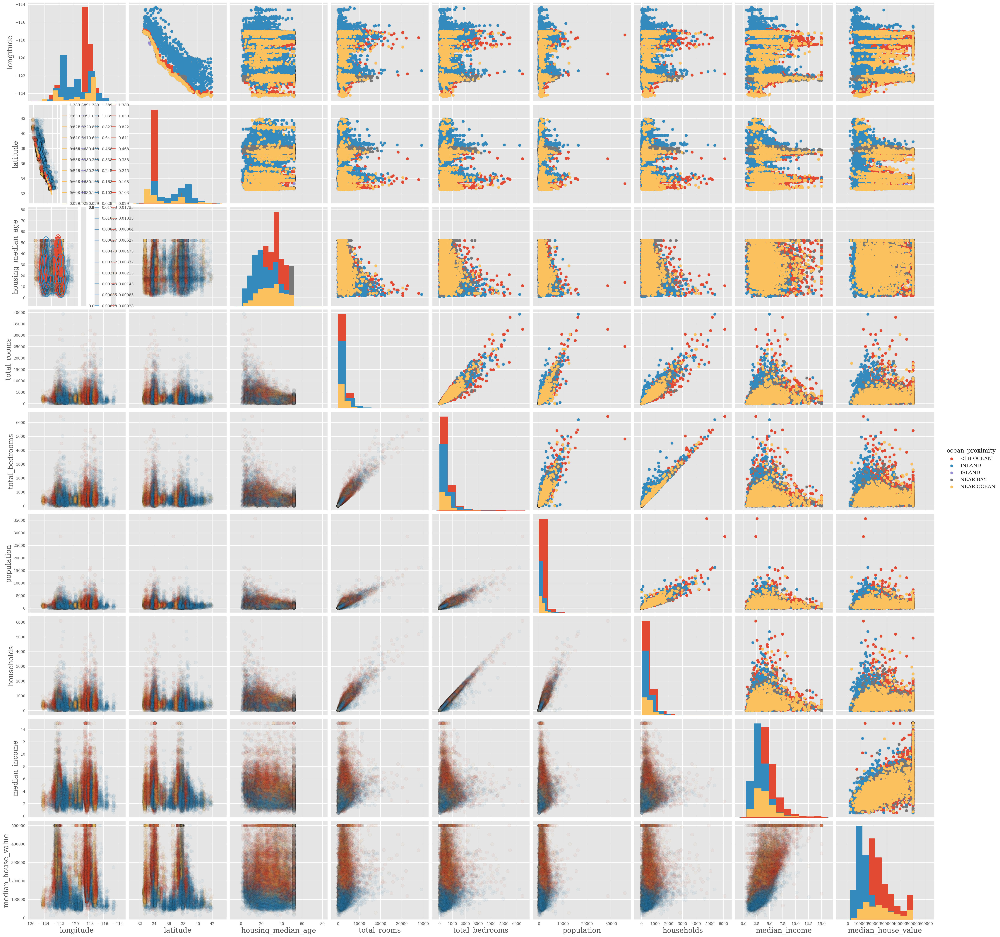

In [59]:

sample = data
fig = sns.pairplot(sample, 
                   plot_kws = {'alpha': 0.05, 's': 80, 'edgecolor': 'k'}, 
                   size=4, hue='ocean_proximity');
fig.map_diag(plt.hist);
fig.map_upper(plt.scatter);
fig.map_lower(sns.kdeplot, shade=False, shade_lowest=False, cbar=True);
plt.tight_layout()

In [ ]:
plt.rcParams['figure.figsize'] = '5,5'
sns.catplot(x="latitude", y="ocean_proximity", kind="boxen",
            data=data.sort_values("ocean_proximity"));

In [ ]:
features = data.columns.tolist()
features.remove('ocean_proximity') # it is a categorical

# Because there are 9 numerical features
fig, axes = plt.subplots(3,3, sharey=True, figsize=(20,20))


for i in range(9):
    sns.violinplot(  y    = 'ocean_proximity', 
                     x    = features[i], 
                     data = data,ax=axes[int(i/3), i%3], figsize=(8,8))



In [ ]:
features = data.columns.tolist()
features.remove('ocean_proximity') # it is a categorical

fig, axes = plt.subplots(3,3, sharey=True, figsize=(20,20))

for i in range(9):
    sns.boxplot(  y='ocean_proximity', x = features[i], data=data,ax=axes[int(i/3), i%3] )

In [ ]:
sns.catplot(y="ocean_proximity", kind="count",  alpha=0.5, data=data);

In [ ]:
corr = data.corr()
corr

In [ ]:
# to get the latex output for the document.
print(corr.to_latex())

In [ ]:
corr

In [ ]:
import numpy as np
mask = np.zeros_like(corr)
mask[np.triu_indices_from(mask)] = True
with sns.axes_style("white"):
    f, ax = plt.subplots(figsize=(7, 5))
    ax = sns.heatmap(corr, mask=mask, vmax=.3, square=True)

# Basic Regression Model

Let us now build a regression model using RandomForest for the housing dataset. let's first prepare teh dataset for analysis

## Data Preprocessing

Here we perform the two steps:
* convert the categorical to one-hot encoding
* drop the missing values
* extract out the feature-space X, and the target (label) variable. 

In [ ]:
data_one_hot = pd.get_dummies(data, 
                              columns=['ocean_proximity'], 
                              prefix = ['ocean_proximity'])
data_one_hot.dropna(inplace=True) 
y = data_one_hot.median_house_value
X = data_one_hot.drop('median_house_value', axis=1)

X.describe(include='all').transpose()

## Log transform
We noticed that some of the features show a strong right skew. In order to address it, let us take a log-transform in order to try to make them look a bit more symmetrical.

In [ ]:
X.total_bedrooms = np.log(X.total_bedrooms)
X.population = np.log(X.population)
X.total_rooms = np.log(X.total_rooms)
X.households = np.log(X.households)
X.median_income = np.log(X.median_income)
y = np.log(y)
X.describe().transpose()

In [ ]:
rc('text', usetex=False)
X.hist(bins=50, alpha = 0.4, color='salmon', xrot=90, figsize=(20,20), layout=(5,3));

## Data split into train and test

In [ ]:
X_train, X_test, y_train, y_test = train_test_split(X, y, random_state=0, )

## Simple linear regression model 

Let us build a baseline linear regression model with this data:

In [ ]:

linear_model = LinearRegression()
linear_model.fit(X_train, y_train)
labels = linear_model.predict(X_test)

# Check how good are the predictions?
mse         = mean_squared_error(y_test, labels)
print(f"Mean squared error: {mse:.2f}")
r2 = r2_score(y_test, labels)
print(rf"Coefficient of Determination (R^2):{r2:0.4f}")
print(rf'Model coefficients are: {linear_model.coef_}')


In [ ]:
rc ('text', usetex=True) # Enable it selectively
from yellowbrick.regressor import residuals_plot
plt.rcParams[ 'figure.figsize' ] = '20,10'               # landscape format figures
viz = residuals_plot(linear_model, X_train, y_train, X_test, y_test, 
                     title=r'\textsc{\Huge Residuals Plot for the Linear Regression regression model}')

### Prediction Errors Plot

In [ ]:
from yellowbrick.regressor import prediction_error

visualizer = prediction_error(linear_model, X_train, y_train, X_test, y_test,
                             title=r'\textsc{\Large Prediction Error for the linear regression model}',
                             xlabel=r'$\mathbf{y}$', ylabel=r'$\mathbf{\hat{y}}$')

### Cook's Distance to see point of high influence (leverage)

In [ ]:
from yellowbrick.regressor import cooks_distance
cooks_distance(
    X_train, y_train,
    draw_threshold=True,
    linefmt="C0-", markerfmt=",",
    title=r"\textsc{\Huge Cook's Distance Outlier Detection}"
    
)

## try regularlization ?
regularizaton using say Ridge-Regularization for the regression give us a better result?

In [ ]:
from sklearn.linear_model import RidgeCV
ridge_model = RidgeCV(alphas=[1e-3, 1e-2, 1e-1, 1]).fit(X_train, y_train)

labels = ridge_model.predict(X_test)

# Check how good are the predictions?
mse         = mean_squared_error(y_test, labels)
print(f"Mean squared error: {mse:.2f}")
r2 = r2_score(y_test, labels)
print(rf"Coefficient of Determination (R^2):{r2:0.4f}")
print(rf'Model coefficients are: {ridge_model.coef_}')

In [ ]:
from yellowbrick.regressor import residuals_plot
plt.rcParams[ 'figure.figsize' ] = '20,10'               # landscape format figures
viz = residuals_plot(ridge_model, X_train, y_train, X_test, y_test, 
                     title=r'\textsc{\Huge Residuals Plot for the Ridge Regression regression model}')

### Prediction Errors Plot

In [ ]:
from yellowbrick.regressor import prediction_error

visualizer = prediction_error(ridge_model, X_train, y_train, X_test, y_test,
                             title=r'\textsc{\Large Prediction Error for the ridge regression model}',
                             xlabel=r'$\mathbf{y}$', ylabel=r'$\mathbf{\hat{y}}$')